In [37]:
import torch
import numpy as np
import os
import matplotlib.pyplot as plt
import cv2

%matplotlib inline

In [2]:
model = torch.hub.load('ultralytics/yolov5', 'custom', path='weights/20e_street_20e_printed.pt')

Using cache found in /Users/jakubdulas/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2022-12-23 Python-3.9.13 torch-1.13.1 CPU

Fusing layers... 
Model summary: 157 layers, 7020913 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 


In [123]:
def intersection_over_union(boxes_preds, boxes_labels):
    box1_x1 = boxes_preds[0]
    box1_y1 = boxes_preds[1]
    box1_x2 = boxes_preds[2]
    box1_y2 = boxes_preds[3] 
    box2_x1 = boxes_labels[0]
    box2_y1 = boxes_labels[1]
    box2_x2 = boxes_labels[2]
    box2_y2 = boxes_labels[3]

    x1 = np.max([box1_x1, box2_x1])
    y1 = np.max([box1_y1, box2_y1])
    x2 = np.min([box1_x2, box2_x2])
    y2 = np.min([box1_y2, box2_y2])

    intersection = (x2 - x1) * (y2 - y1)

    box1_area = abs((box1_x2 - box1_x1) * (box1_y2 - box1_y1))
    box2_area = abs((box2_x2 - box2_x1) * (box2_y2 - box2_y1))

    return intersection / (box1_area + box2_area - intersection + 1e-6)

0.9306959922554656


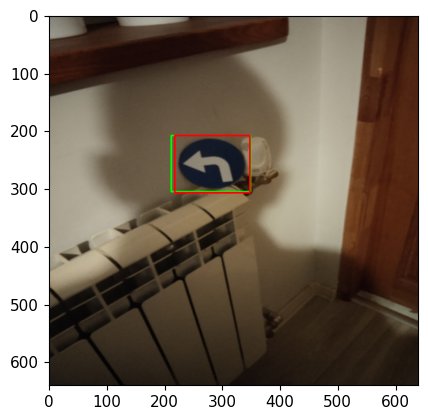

In [128]:
image_file = 'C-4-train_10.png'
img = cv2.imread(os.path.join('data', 'test', 'images', image_file))
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img = cv2.resize(img, (640, 640))
label_name = image_file.split('.')[0]

with open(os.path.join('data', 'test', 'labels', label_name+'.txt')) as f:
    real_cls, xc, yc, w, h = f.readline().split(' ')
    real_cls = int(float(real_cls))
    xc = float(xc)
    yc = float(yc)
    w = float(w)
    h = float(h)

    x1 = int((xc - w/2)*640)
    x2 = int((xc + w/2)*640)
    y1 = int((yc - h/2)*640)
    y2 = int((yc + h/2)*640)

    labels = [x1, y1, x2, y2]

img_with_rect = cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)

result = model(img)

x1, y1, x2, y2, pred, cls = result.xyxy[0][0]

x1 = int(x1)
x2 = int(x2)
y1 = int(y1)
y2 = int(y2)
cls = int(cls)

preds = [x1, y1, x2, y2]

img_with_rect = cv2.rectangle(img_with_rect, (x1, y1), (x2, y2), (255, 0, 0), 2)

plt.imshow(img_with_rect)

iou = intersection_over_union(preds, labels)
print(iou)

In [141]:
test_images = os.listdir('data/test/images')
well_predicted = 0
num_preds = 0
ious = 0
predicted_images = []

for image_file in test_images:
    label_name = image_file.split('.')[0]

    original_img = cv2.imread(os.path.join('data', 'test', 'images', image_file))
    img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (640, 640))

    with open(os.path.join('data', 'test', 'labels', label_name+'.txt')) as f:
        real_cls, xc, yc, w, h = f.readline().split(' ')
        real_cls = int(float(real_cls))
        xc = float(xc)
        yc = float(yc)
        w = float(w)
        h = float(h)

        x1 = int((xc - w/2)*640)
        x2 = int((xc + w/2)*640)
        y1 = int((yc - h/2)*640)
        y2 = int((yc + h/2)*640)

        labels = [x1, y1, x2, y2]

    result = model(img)
    predicted_images.append(result.render()[0])

    preds = result.xyxy[0][0][:4].numpy()
    cls = result.xyxy[0][0][5]
    cls = int(cls)

    if cls == real_cls:
        well_predicted += 1

    num_preds += 1
    ious += intersection_over_union(preds, labels)

### Predictions accuracy

In [142]:
accuracy = well_predicted/num_preds
accuracy

1.0

### Intersection over union mean

In [143]:
ious/num_preds

0.8994705008383016

In [144]:
import matplotlib.pyplot as plt
%matplotlib inline

def show_images(images, cols=0, rows=1, labels=[], figsize=(10, 7)):
    def get_element(elements):
        for e in elements:
            yield e

    if not cols:
        cols =int(np.ceil(len(images)/rows))

    count = 0

    image_gen = get_element(images)

    if len(labels):
        label_gen = get_element(labels)
    
    fig = plt.figure(figsize=figsize)

    for _ in range(rows):
        for _ in range(cols):
            count += 1

            if count >len(images): return 
            fig.add_subplot(rows, cols, count)

            img = next(image_gen)
            plt.imshow(img)
            plt.axis('off')

            if len(labels):
                plt.title(next(label_gen))

## Displaying images

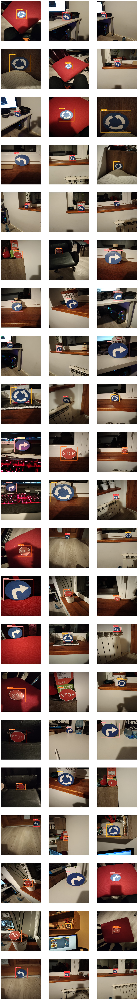

In [156]:
show_images(predicted_images, cols=3, rows=50, figsize=(20, 350))